In [1]:
!pip install -r ../../../requirements.txt --quiet
!pip install ../../../ --quiet

# VFBTerm and VFBTerms Class Demonstration
This notebook demonstrates the usage of the `vfb.term` and `vfb.terms` methods for accessing VFB term information.
We'll explore how to create `VFBTerm` objects, access related terms, images, and use advanced features like lazy loading of parents and manipulating collections of terms with `VFBTerms`.

In [2]:
# Import the VFBConnect class
from vfb_connect import vfb

Welcome to the Virtual Fly Brain API
See the documentation at: https://virtualflybrain.org/docs/tutorials/apis/

Establishing connections to https://VirtualFlyBrain.org services...
Session Established!

Type vfb. and press tab to see available queries. You can run help against any query e.g. help(vfb.terms)


## Creating and Exploring VFBTerm Objects
We'll start by creating a `VFBTerm` object using the `vfb.term` method.

In [3]:
# Example of creating a VFBTerm object using a term name
vfb_term = vfb.term('medulla')
vfb_term

VFBTerm(term=Term(term=MinimalEntityInfo(name=medulla, short_form=FBbt_00003748), link=https://n2t.net/vfb:FBbt_00003748))

### Accessing Term Information
You can access various details about the term, including its name, description, and related terms.

In [4]:
# Accessing term details
print(f"Name: {vfb_term.name}")
print(f"ID: {vfb_term.id}")
print(f"Description: {vfb_term.description}")
print(f"Related Terms: {vfb_term.related_terms}")

Name: medulla
ID: FBbt_00003748
Description: The second optic neuropil, sandwiched between the lamina and the lobula complex. It is divided into 10 layers: 1-6 make up the outer (distal) medulla, the seventh (or serpentine) layer exhibits a distinct architecture and layers 8-10 make up the inner (proximal) medulla (Ito et al., 2014).
Related Terms: Relations(Rel(relation=MinimalEdgeInfo(label=develops from, type=develops_from), object=VFBTerm(term=Term(term=MinimalEntityInfo(name=medulla anlage, short_form=FBbt_00001935), link=https://n2t.net/vfb:FBbt_00001935)), confidence=None), Rel(relation=MinimalEdgeInfo(label=is part of, type=part_of), object=VFBTerm(term=Term(term=MinimalEntityInfo(name=adult optic lobe, short_form=FBbt_00003701), link=https://n2t.net/vfb:FBbt_00003701)), confidence=None))


Related Terms: Relations(Rel(relation=MinimalEdgeInfo(label=develops from, type=develops_from), object=VFBTerm(term=Term(term=MinimalEntityInfo(name=medulla anlage, short_form=FBbt_00001935), link=https://n2t.net/vfb:FBbt_00001935)), confidence=None), Rel(relation=MinimalEdgeInfo(label=is part of, type=part_of), object=VFBTerm(term=Term(term=MinimalEntityInfo(name=adult optic lobe, short_form=FBbt_00003701), link=https://n2t.net/vfb:FBbt_00003701)), confidence=None))


## Lazy Loading of Parents
The `VFBTerm` class supports lazy loading for parents. The parents are only loaded when accessed (for the first time) since parents are themselves fully featured VFBTerms annd hence have their own parents etc.

In [5]:
# Accessing parents (lazy loading)
parents = vfb_term.parents
print(f"Parents: {parents}")

Pulling 2 terms from VFB...
Parents: VFBTerms(['anterior ectoderm derivative', 'synaptic neuropil domain'])


## Working with Multiple Terms using `vfb.terms`
You can work with multiple terms at once using the `vfb.terms` method. Let's see how to create a `VFBTerms` object and perform operations on it.

In [6]:
# Example of creating a VFBTerms object using a list of term names
vfb_terms = vfb.terms(['medulla', 'nodulus'])
vfb_terms

Pulling 2 terms from VFB...


VFBTerms(terms=VFBTerms(['medulla', 'nodulus']))

### Accessing Multiple Terms
You can iterate over `VFBTerms` to access individual `VFBTerm` objects.

In [7]:
# Iterating over VFBTerms
for term in vfb_terms:
    print(term.name)

# though several methods exist to speed up common requirements like this:
print(f"names: {vfb_terms.get_names()}")
print(f"ids: {vfb_terms.get_ids()}")


medulla
nodulus
names: ['medulla', 'nodulus']
ids: ['FBbt_00003748', 'FBbt_00003680']


### Additional Features
The `vfb` object provides several other methods for interacting with terms, such as `get_summaries`, `load_skeletons`, and `plot3d`. These can be explored similarly using the `vfb.term` and `vfb.terms` methods.

In [8]:
print(f"summary of all: {vfb_terms.get_summaries()}")

summary of all:               ID     Name                                        Description  \
0  FBbt_00003748  medulla  The second optic neuropil, sandwiched between ...   
1  FBbt_00003680  nodulus  Paired synaptic neuropil domain of the adult b...   

                                 URL  \
0  https://n2t.net/vfb:FBbt_00003748   
1  https://n2t.net/vfb:FBbt_00003680   

                                       Related Terms  \
0  [Rel(relation=MinimalEdgeInfo(label=develops f...   
1  [Rel(relation=MinimalEdgeInfo(label=develops f...   

                                            Parents  \
0  [fibrous neuropil, anterior ectoderm derivative]   
1                [fibrous neuropil, UBERON_0001062]   

                                        Publications  \
0  [Ito et al., 2014, Neuron 81(4): 755--765, Nér...   
1  [Hanesch et al., 1989, Cell Tissue Res. 257(2)...   

                                Cross References  
0  [https://insectbraindb.org/app/structures/38]  
1  [https://inse

In [9]:
vfb_terms.plot3d()

Nothing found to plot


plot3d needs to be applied to instances rather than types

Pulling 2 terms from VFB...
summary of all:              ID                             Name Description  \
0  VFB_00102107  ME on JRC2018Unisex adult brain               
1  VFB_00102282  NO on JRC2018Unisex adult brain               

                                URL             Parents Publications  \
0  https://n2t.net/vfb:VFB_00102107     [optic medulla]           []   
1  https://n2t.net/vfb:VFB_00102282  [ventral tubercle]           []   

       License                     Datasets  
0  CC-BY-NC-SA  [JRC 2018 templates & ROIs]  
1  CC-BY-NC-SA  [JRC 2018 templates & ROIs]  
Defaulting to JRC2018Unisex template


INFO  : Using "plotly" backend for 3D plotting. (navis)


Plotting 3D representation of 2 items


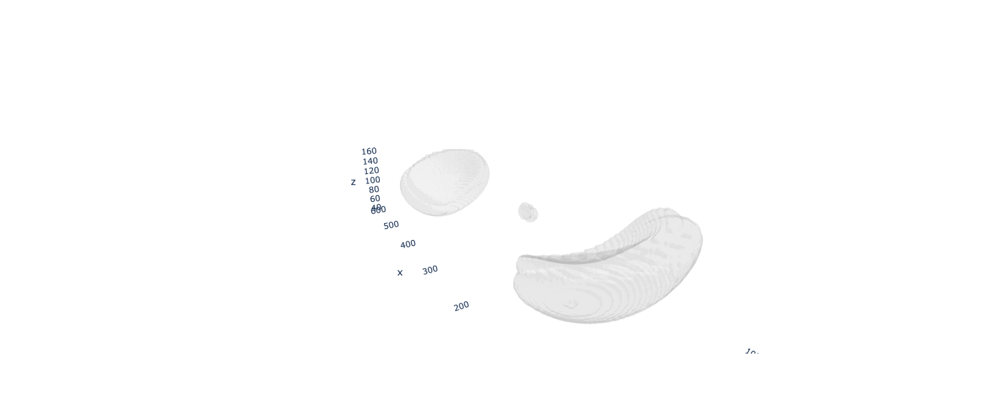

In [10]:
vfb_regions = vfb.terms(['medulla on JRC2018Unisex adult brain', 'nodulus on JRC2018Unisex adult brain'])

print(f"summary of all: {vfb_regions.get_summaries()}")

vfb_regions.plot3d()

Next we might want to add some neurons using the queries we learn in the other turorials.

In [11]:
vfb_neurons = vfb.owl_instances("'neuron' that 'has synaptic terminal in' some 'nodulus' and 'has synaptic terminal in' some 'medulla'", limit = 10)
print(f"summary of all: {vfb_neurons.get_summaries()}")

Limiting to 10 instances out of 1
Pulling 1 terms from VFB...
summary of all:              ID         Name                           Description  \
0  VFB_jrchk542  SIFa(PDM34)  tracing status-Traced, cropped-False   

                                URL  \
0  https://n2t.net/vfb:VFB_jrchk542   

                                       Related Terms  \
0  [Rel(relation=MinimalEdgeInfo(label=capable of...   

                                             Parents License  \
0  [mushroom body octopaminergic neuron, adult oc...   CC_BY   

                                    Cross References  \
0  [https://neuprint.janelia.org/results?dataset=...   

                                      Datasets  
0  [JRC_FlyEM_Hemibrain neurons Version 1.2.1]  


We can add and subtract VFBTerms from each other (uniqueness is enforced by id)

Defaulting to JRC2018Unisex template
Plotting 3D representation of 3 items


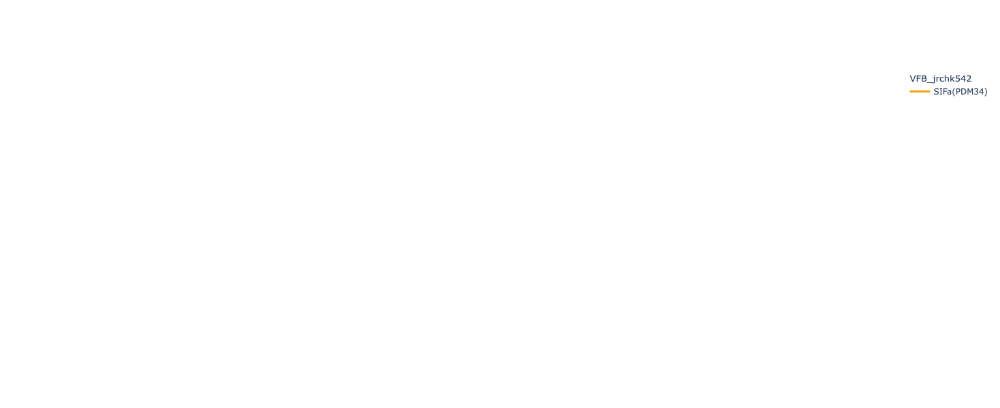

In [12]:
# So to plot both the regions and the neurons in the same plot:
plot_terms = vfb_regions + vfb_neurons
plot_terms.plot3d()

**Note:** some of the neurons exist in mutiple templates so it is good practice to specify the template space you want to work in otherwise the first template space plotted is enforced:

**Note:** Although ```navis.plot3d()``` method we use can cope with hundreds of skeletons to avoid the risk of cooking your GPU you can limit your plots to a subset (```[:10]``` - first 10) or sample (```[::50]``` - every 50th) etc.

Limiting to 10 instances out of 1092
Pulling 10 terms from VFB...
Plotting 3D representation of 10 items


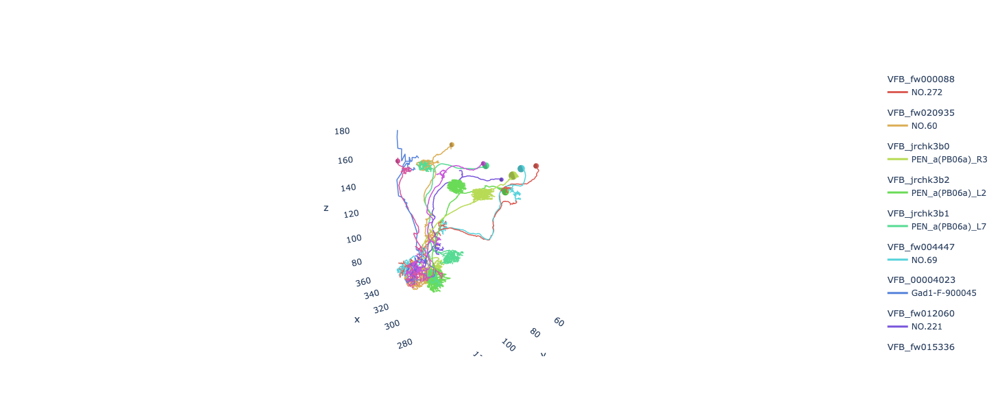

In [13]:
terms = vfb.owl_instances("'neuron' that 'has presynaptic terminals in' some 'nodulus'", return_dataframe=False, limit=10)
terms[0:10].plot3d(template='JRC2018Unisex')

It's often handy to include the template mesh for conntext to see where the above neurons are located:

Plotting 3D representation of 10 items
Adding template VFB_00101567 to the plot
Defaulting to JRC2018Unisex template


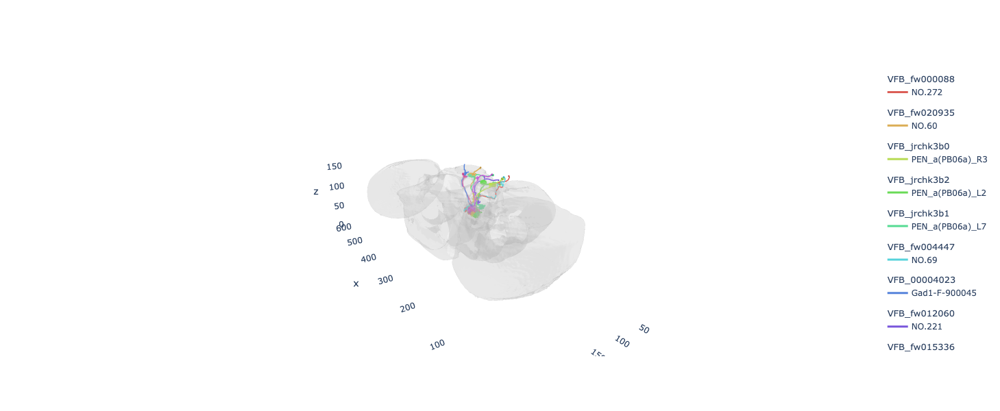

In [14]:

terms[0:10].plot3d(template='JRC2018Unisex', include_template=True)

If a template has painted regions then these can also be accessed as VFBTerms object via ```template.regions```:

In [15]:
template=vfb.term('JRC2018Unisex')

colours=vfb.generate_lab_colors(len(template.regions))

subregions=template.regions[::5] # Just to speed up the plotting selecting every 5th region

subregions.plot3d(template=template, color=colours, hover_name=True)

Pulling 47 terms from VFB...


Loading Terms: 100%|█████████████████████████████████████████████████████████████████████████████████████████████| 47/47 [00:00<00:00, 18300.44it/s]


Plotting 3D representation of 10 items


In [16]:
med = vfb_terms[0] # grabing the medulla type term we had earlier

med.instances #pulling all instances of that type

Loading instances ids for the first time...
Creating instances for the first time...
Pulling 4 terms from VFB...


VFBTerms(terms=VFBTerms(['ME(R) on JRC_FlyEM_Hemibrain', 'ME on JRC2018Unisex adult brain', 'medulla on adult brain template JFRC2', 'medulla on adult brain template Ito2014']))

In [17]:
med.instances.plot3d() #plotting all instances of that type. Note: without a template specified the first instance loaded will fix the template space and block the rest as they belong in different templates.

Defaulting to JRC2018Unisex template
Plotting 3D representation of 1 items


Please see [VFBTerm DataSet Notebook](vfb_datasets.html) for examples of how to work with whole datasets